In [1]:
import rasterio
import glob
import os,sys
from skimage.transform import rescale, resize, downscale_local_mean
from matplotlib import pyplot as plt
import numpy as np
from scipy import misc
import fiona
import geopandas as gpd
from shapely.geometry import shape
import shapely
from rasterio.mask import mask
from pyproj import Proj, transform

%matplotlib inline

In [2]:
# convert bounding boxes into string required for DG CatalogImage
# ex. bbox = [-110.85299491882326,32.167148499672855,-110.84870338439943,32.170236308395644] WGS84
def rioBoundBoxUTM_toWGS84(bounds_obj, src_crs, wgs84='4326'):
    
    wgs = Proj(init='epsg:{}'.format(wgs84))
    p2 = Proj(init=str(src_crs['init']))
    
    try:
        min_x, min_y = transform(p2, wgs, bounds_obj.left, bounds_obj.bottom)
        max_x, max_y = transform(p2, wgs, bounds_obj.right, bounds_obj.top)
    except:
        min_x, min_y = transform(p2, wgs, bounds_obj[0], bounds_obj[1])
        max_x, max_y = transform(p2, wgs, bounds_obj[2], bounds_obj[3])
    
    return min_x, min_y, max_x, max_y

def rioBoundBoxWGS84_toUTM(bounds_obj, src_crs, wgs84='4326'):
    
    #print(src_crs['init'])
    wgs = Proj(init='epsg:{}'.format(wgs84))
    #p2 = Proj(init=str(src_crs['init']))
    p2 = Proj(init='epsg:{}'.format(str(src_crs['init'])))
    min_x, min_y = transform(wgs, p2, bounds_obj[0], bounds_obj[1])
    max_x, max_y = transform(wgs, p2, bounds_obj[2], bounds_obj[3])
    
    return min_x, min_y, max_x, max_y

# define a function to check the image bounds of the two datasets
def imageIntersectionTest(dg_bounds, planet_bounds):
    
    res = ''
    if dg_bounds[0] > planet_bounds[0]:
        res += ' DG xmin is gt PL xmin'
        
    if dg_bounds[1] > planet_bounds[1]:
        res += ' DG ymin is  gt PL ymin'
        
    if dg_bounds[2] < planet_bounds[2]:
        res += ' DG xmax is lt PL xmax'
        
    if dg_bounds[3] < planet_bounds[3]:
        res += ' DG ymax is lt PL ymax'
        
    return res

## define a function to get the chip dimensions from a larger bounding box and a chip dimension
def generateChipBoxesUTM(bbox, box_dim):
    
#     xmin, ymin, xmax, ymax = bbox.bounds
#     xmin_chips = np.arange(xmin, xmax - box_dim, box_dim)
#     xmax_chips = np.arange(xmin + box_dim, xmax, box_dim)
#     ymin_chips = np.arange(ymin, ymax - box_dim, box_dim)
#     ymax_chips = np.arange(ymin + box_dim, ymax, box_dim)
    
    
    # try a for loop
    for_loop_result = []
    for l_x in np.arange(xmin, xmax-box_dim, box_dim):
        for l_y in np.arange(ymin, ymax-box_dim, box_dim):
            res = [l_x, l_y, l_x + box_dim, l_y + box_dim ]
            for_loop_result.append(res)
    
    return  for_loop_result

def generateChipBoxesUTM_WGS84(bbox, box_dim, crs):
    
    # get bounds
    xmin, ymin, xmax, ymax = bbox.bounds
    print(xmax-xmin)
    print(ymax-ymin)
    
    # try a for loop
    utm_chips = []
    wgs84_chips = []
    
    # construct chip bounds
    for l_x in np.arange(xmin, xmax-box_dim, box_dim):
        for l_y in np.arange(ymin, ymax-box_dim, box_dim):
            
            res = [l_x, l_y, l_x + box_dim, l_y + box_dim ]
            utm_chips.append(res)
            arg = box(res[0], res[1], res[2], res[3]).bounds
            wgs84_chips.append( rioBoundBoxUTM_toWGS84(arg, crs))
            
    return utm_chips, wgs84_chips

def chip_planet_image(impath, bbox, out_file):
    
    first = (bbox[0], bbox[1])    # xmin, ymin
    second = (bbox[0], bbox[3])   # xmin, ymax
    third = (bbox[2], bbox[3])    # xmax, ymax
    fourth = (bbox[2], bbox[1])   # xmax, ymin
    
    ## construct the geometry for rasterio.mask.mask
    bbox_geom = shapely.geometry.Polygon([first, second, third, fourth, first])
    geom = [shapely.geometry.mapping(bbox_geom)]
    
    # read the image
    with rasterio.open(impath, 'r') as src:
        out_image, out_transform = mask(src, geom, crop=True)
        out_meta = src.meta.copy()
        
    # get some pixel metrics
    num_nonzero = np.count_nonzero(out_image[0,:,:])
    num_pixels = out_image[0,:,:].size
    ratio = float(num_nonzero) / float(num_pixels)
    
    ## skip this one if not enough pixels
    if ratio < 0.95:
        return False
    
    else: #continue with the writing
    
        # update the metadata
        out_meta.update({"driver": "GTiff",
                     "height": out_image.shape[1],
                     "width": out_image.shape[2],
                     "transform": out_transform})

        # write the file
        with rasterio.open(out_file, "w", **out_meta) as dest:
            dest.write(out_image)

        return True

def chip_dg_image(dg_scene, bbox, dg_out_file):
    
    print('bbox {}'.format(bbox))
    
    # get the aoi
    img_aoi = dg_scene.aoi(bbox=bbox)
    
    # save the file
#     print(dg_out_file)
    img_aoi.geotiff(path=dg_out_file)
    
    return


In [3]:
# specify scene id for DG data
dg_scene_id = '1030010057062200'

# specify image for 2.0 meter analysis
gt_image_2 = '../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif' # desktop
gt_image_2 = '../rasters/union_impervious_raster_2_0_0.tif' # laptop
#gt_image_2 = 'C:/projects/smart_cities/Denver_Sample_Sites/rasters/union_impervious_raster_2_0.tif'

# specify images for 0.5 meter analysis
gt_image_05 = '../Denver_Sample_Sites/rasters/union_impervious_raster_0_5.tif' # desktop
gt_image_05 = '../rasters/union_impervious_raster_0_5.tif' # laptop
#gt_image_05 = 'C:/projects/smart_cities/Denver_Sample_Sites/rasters/union_impervious_raster_0_5.tif'

# specify the shapefile
# shpfile = '../Denver_Sample_Sites/union/union_grid_index256.shp'
shpfile = '../Denver_Sample_Sites/union/union.shp' # desktop
shpfile = '../union/union.shp' # desktop
rows = []
with fiona.open(shpfile) as shp:
    crs = shp.crs
#     for s in shp:
#         # rows.append(shape(s['geometry']))
#         pass
        
        
    shp_bounds = shp.bounds


Sample Points

1) random sample row and column in GBDX image 
* get lon / lat from Affine object
* sample from rasterio object
 - get row / column from Ground Truth image, create window
 - if window is not NaN, then get it and save both

In [8]:
from gbdxtools import Interface, CatalogImage

# connect to gbdx
gbdx = Interface()

# get the dask array for the 8 band MS image
img_2m = CatalogImage(dg_scene_id, band_type='MS', bbox=shp_bounds, acomp=True)
rows, cols = img_2m.shape[1:]

# get the dask array for the Pansharpened, 4 band image
image_05m = CatalogImage(dg_scene_id, band_type='MS', bbox=shp_bounds, acomp=True, pansharpen=True)
rowsP, colsP = image_05m.shape[1:]
pan_factorR = np.floor(rowsP/rows)
pan_factorC = np.floor(colsP/cols)

In [48]:
## define a function to get the row column coordinates
from pyproj import Proj, transform

def assignRC(rio_obj, samp_pt, window_size=64, inproj='epsg:4326', outproj='epsg:32613'):
    # project the point to source crs
    outProj = Proj(init=outproj)
    inProj = Proj(init=inproj)
    x1,y1 = samp_pt
    x2,y2 = transform(inProj,outProj,x1,y1)
    
    # get the row column
    temp = src.index(x2,y2)
    r,c = [int(c) for c in temp]
    
    return (samp_pt, r,c)

def verifyWindow(rio_obj, samp_pt, window_size=64, inproj='epsg:4326', outproj='epsg:32613'):
    # project the point to source crs
    outProj = Proj(init=outproj)
    inProj = Proj(init=inproj)
    x1,y1 = samp_pt
    x2,y2 = transform(inProj,outProj,x1,y1)
    
    # get the row column
    temp = src.index(x2,y2)
    r,c = [int(c) for c in temp]
    
    # check what the sample window would look like
    r_start = int(r - window_size/2)
    r_end = int(r_start + window_size)
    c_start = int(c - window_size/2)
    c_end = int(c_start + window_size)
    
    
    try:
        arr = rio_obj.read()
        win_arr = arr[:,r_start:r_end, c_start:c_end]
        
        
        # if it is all zero or all NaN and at least 95% data
        test_arr = win_arr[0]
        test_nan = np.isnan(np.mean(test_arr))
        test_zero = np.mean(test_arr) == 0
        
        
#         print('here')
#         plt.imshow(test_arr)
#         plt.colorbar()
#         plt.show()
        
         # get some pixel metrics
        num_nonzero = test_arr.size
        num_pixels = test_arr[test_arr == 3].size
        ratio = float(num_pixels) / float(num_nonzero)
#         print(ratio)
        
        # empirically choose no-data ratio of 10% of window
        if (test_nan or test_zero or (ratio > 0.10)) :
            # if either of the tests fail, we don't want that window
            
            pass
        else:
            return [samp_pt, r,c]
        
    except Exception as e:
        print(e)
        # should only happen if start/end coordinates are outside of image bounds. 
        # in that case, we don't want it
        pass
    
## calculate the lon/lat of the random coordinates 
def calcXYfromRC(aff, coords):
    col = coords[1]
    row = coords[0]
    
    # get the origin (why is DG storing Affine transform this way???)
    ox = aff[2]
    oy = aff[5]
    
    # calculate lon / lat
    cx = ox + aff[0]*col
    cy = oy + aff[4]*row
    
    return (cx,cy)


# lonlat_MS = [calcXYfromRC(img_2m.affine, pair) for pair in coords]
# lonlat_PAN = [calcXYfromRC(image_05m.affine, pair) for pair in coords_pan]
    
def checkWindow(rio_obj, samp_pt, window_size=64, inproj='epsg:4326', outproj='epsg:32613'):
    
    try:
        # project the point to source crs
        outProj = Proj(init=outproj)
        inProj = Proj(init=inproj)
        x1,y1 = samp_pt
        x2,y2 = transform(inProj,outProj,x1,y1)

        # get the row column
        temp = src.index(x2,y2)
        r,c = [int(c) for c in temp]

        # check what the sample window would look like
        r_start = int(r - window_size/2)
        r_end = int(r_start + window_size)
        c_start = int(c - window_size/2)
        c_end = int(c_start + window_size)


        arr = rio_obj.read()
        win_arr = arr[:,r_start:r_end, c_start:c_end]


        # if it is all zero or all NaN and at least 95% data
        test_arr = win_arr[0]
        test_nan = np.isnan(np.mean(test_arr))
        test_zero = np.mean(test_arr) == 0

         # get some pixel metrics
        num_nonzero = test_arr.size
        num_pixels = test_arr[test_arr == 3].size
        ratio = float(num_pixels) / float(num_nonzero)
    #         print(ratio)

        # empirically choose no-data ratio of 10% of window
        if (test_nan or test_zero or (ratio > 0.10)) :
            # if either of the tests fail, we don't want that window

            return True
        else:
            return False
    
    except:
        return True
        
    

In [16]:
# generate the sample points
# we have some funny stuff from ArcGIS converting the polygons to a raster... so... 
# generate the points within the bounds of the shapefile / DG image array

import random

num = 10000
side = 64
coords = []
coords_pan = []
im_patches = []
im_patches_pan = []

with rasterio.open(gt_image_2, 'r') as src:
    
    for i in range(num):
        ran_row, ran_col = random.randrange(0,rows), random.randrange(0,cols) 

        try:
            r_start = ran_row - side/2
            r_end = ran_row + side/2
            c_start = ran_col - side/2
            c_end = ran_col + side/2
            #im_data = img_2m[:, r_start:r_end, c_start:c_end]

            pr_start = ran_row*pan_factorR - side/2
            pr_end = ran_row*pan_factorR + side/2
            pc_start = ran_col*pan_factorC - side/2
            pc_end = ran_col*pan_factorC + side/2
            #im_data_pan = image_05m[:, pr_start:pr_end, pc_start:pc_end]

            # append regardless and check later.

            #############################################################################################################
            ### SHOULD CHECK THE INFORMATION THRESHOLDS BELOW, BUT HERE, TO RESELECT ROWS AND COLUMNS UNTIL IT IS MET ###
            #############################################################################################################

            s_pt = calcXYfromRC(img_2m.affine, (ran_row, ran_col))
            pt_flag = checkWindow(src, s_pt)
            while pt_flag:
                ran_row, ran_col = random.randrange(0,rows), random.randrange(0,cols)
                s_pt = calcXYfromRC(img_2m.affine, (ran_row, ran_col))
                pt_flag = checkWindow(src, s_pt)

            coords.append((ran_row, ran_col))
            coords_pan.append(( int(ran_row*pan_factorR), int(ran_col*pan_factorC)))

            # check for nan
    #         if np.isnan(im_data.mean().compute()):
    #             print(i,im_data)
    #         else:
    #             coords.append((ran_row, ran_col))
    #             coords_pan.append(( int(ran_row*pan_factorR), int(ran_col*pan_factorC)))
    #             #im_patches.append(im_data)
    #             #im_patches_pan.append(im_data_pan)
        except Exception as e:
            print(e)
    #         print('{}, out of bounds'.format(i))
    #         print(r_start, r_end, c_start, c_end)

    coords_arr = np.array(coords)  

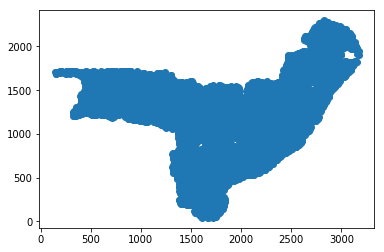

In [19]:
plt.scatter(coords_arr[:,1], coords_arr[:,0])

In [20]:
lonlat_MS = [calcXYfromRC(img_2m.affine, pair) for pair in coords]
lonlat_PAN = [calcXYfromRC(image_05m.affine, pair) for pair in coords_pan]

In [32]:
if False: # not necessary now
    # use the lonlats_* lists to sample the ground truth image. return the histogram if the window is on the border,
    # which should be evident if the window extends across
    with rasterio.open(gt_image_2, 'r') as src:
        #print(src.crs)

        # cull the lon/lat points by checking if they include nodata pixels
        pts_MS = [verifyWindow(src, samp_pt) for samp_pt in lonlat_MS]

    # do the same for the 0.5 meter ground truth raster
    with rasterio.open(gt_image_05, 'r') as src:

        # cull the lon/lat points by checking if they include nodata pixels
        pts_PAN = [verifyWindow(src, samp_pt) for samp_pt in lonlat_MS]
    
    # remove the None entries from the lists
    pts_PAN = [p for p in pts_PAN if p is not None]
    pts_MS = [p for p in pts_MS if p is not None]

In [49]:
if True: # not necessary now
    # use the lonlats_* lists to sample the ground truth image. return the histogram if the window is on the border,
    # which should be evident if the window extends across
    with rasterio.open(gt_image_2, 'r') as src:
        #print(src.crs)

        # cull the lon/lat points by checking if they include nodata pixels
        pts_MS = [assignRC(src, samp_pt) for samp_pt in lonlat_MS]

    # do the same for the 0.5 meter ground truth raster
    with rasterio.open(gt_image_05, 'r') as src:

        # cull the lon/lat points by checking if they include nodata pixels
        pts_PAN = [assignRC(src, samp_pt) for samp_pt in lonlat_MS]
    
    # remove the None entries from the lists
    pts_PAN = [p for p in pts_PAN if p is not None]
    pts_MS = [p for p in pts_MS if p is not None]


In [36]:
## view on map
from shapely.ops import transform
from shapely.geometry import shape, Point

geoms = [Point(pair).buffer(0.00001).__geo_interface__ for pair in lonlat_MS]
    
geojson = {"type": "FetureCollection", "features": []}
for idx, geom in enumerate(geoms):
    g = {
        "type": "Feature",
        "geometry": geom,
        "properties": {"id": idx+1}
    }
    geojson['features'].append(g)
    

print(geojson['features'][0].keys())
# gbdx.vectors.map(features=geojson['features'], zoom=11)
style= {
                        "line-color": '#ff0000',
                        "line-opacity": .99,
                        "line-width": 4
                    }

mapbox_api_key = 'pk.eyJ1Ijoiam9lbWNnY3UiLCJhIjoiY2pla2I1Z2FiMHo2cDJ3bjVwMnJuZWloNiJ9.otjTJOYusw-XYsUohs7ZGg'
gbdx.vectors.map(features=geojson['features'], style=style, zoom=11, api_key=mapbox_api_key)


              

            

dict_keys(['type', 'geometry', 'properties'])


<IPython.core.display.Javascript object>

In [50]:
entry[1:]

((765, 1601),)

### main chipping code.. first ground truth, then DG

In [52]:
# non-geospatial images
gt_out_dir_list = ['nogeo_gt_chips_2_0', 'nogeo_gt_chips_0_5']
gt_images = [gt_image_2, gt_image_05]

i=0
window_size = 64
for gt_im, gt_out_dir, samples in zip(gt_images, gt_out_dir_list, [pts_MS, pts_PAN]):
    
    # create the directory if it doesn't exist
    if not os.path.exists(gt_out_dir):
        os.mkdir(gt_out_dir)
    
    # define the basename of the file
    gt_chip_base = 'im_' + gt_out_dir
    
    
    with rasterio.open(gt_im, 'r') as src:
        
        arr = src.read(1)
        # iterate the points
        for i, entry in enumerate(samples[:100]):
            
            r,c = entry[1:]
            
            # check what the sample window would look like
            r_start = int(r - window_size/2)
            r_end = int(r_start + window_size)
            c_start = int(c - window_size/2)
            c_end = int(c_start + window_size)
            win_arr = arr[r_start:r_end, c_start:c_end]
            
            # status
            print('on item {} of {}'.format(i+1, len(samples)))

            # form the output paths
            gt_out_im = '{}_{:0>12}.tif'.format(gt_chip_base, i)
            gt_out_file = os.path.join(gt_out_dir, gt_out_im)

            plt.imsave(gt_out_file, win_arr)
            
            # chip the ground truth image
            #bbox = rioBoundBoxWGS84_toUTM(shp.bounds, {'init': '32613'}, wgs84='4326') # image is in UTM

            #print(gt_im)
            #chip_planet_image(gt_im, bbox, gt_out_file)

            # update counter
            i+=1



on item 1 of 10000
on item 2 of 10000
on item 3 of 10000
on item 4 of 10000
on item 5 of 10000
on item 6 of 10000
on item 7 of 10000
on item 8 of 10000
on item 9 of 10000
on item 10 of 10000
on item 11 of 10000
on item 12 of 10000
on item 13 of 10000
on item 14 of 10000
on item 15 of 10000
on item 16 of 10000
on item 17 of 10000
on item 18 of 10000
on item 19 of 10000
on item 20 of 10000
on item 21 of 10000
on item 22 of 10000
on item 23 of 10000
on item 24 of 10000
on item 25 of 10000
on item 26 of 10000
on item 27 of 10000
on item 28 of 10000
on item 29 of 10000
on item 30 of 10000
on item 31 of 10000
on item 32 of 10000
on item 33 of 10000
on item 34 of 10000
on item 35 of 10000
on item 36 of 10000
on item 37 of 10000
on item 38 of 10000
on item 39 of 10000
on item 40 of 10000
on item 41 of 10000
on item 42 of 10000
on item 43 of 10000
on item 44 of 10000
on item 45 of 10000
on item 46 of 10000
on item 47 of 10000
on item 48 of 10000
on item 49 of 10000
on item 50 of 10000
on item 5

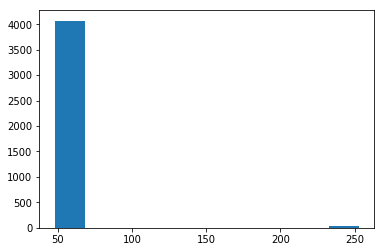

In [53]:
with rasterio.open(r"C:\Projects\smart_cities\impervious_surface_analysis\nogeo_gt_chips_0_5\im_nogeo_gt_chips_0_5_000000000093.tif", 'r') as src:
    arr = src.read(1)
    
plt.hist(arr.ravel())
plt.show()

In [15]:

gt_out_dir_list = ['gt_chips_2_0', 'gt_chips_0_5']
gt_images = [gt_image_2, gt_image_05]

i=0
for gt_im, gt_out_dir in zip(gt_images, gt_out_dir_list):
    
    # create the directory if it doesn't exist
    if not os.path.exists(gt_out_dir):
        os.mkdir(gt_out_dir)
    
    # define the basename of the file
    gt_chip_base = 'im_' + gt_out_dir
    
    # iterate the geometries
    for i, shp in enumerate(rows):
    
        # status
        print('on item {} of {}'.format(i+1, len(rows)))
        
        # form the output paths
        gt_out_im = '{}_{:0>12}.tif'.format(gt_chip_base, i)
        gt_out_file = os.path.join(gt_out_dir, gt_out_im)

        # chip the ground truth image
        bbox = rioBoundBoxWGS84_toUTM(shp.bounds, {'init': '32613'}, wgs84='4326') # image is in UTM
        
        print(gt_im)
        chip_planet_image(gt_im, bbox, gt_out_file)

        # update counter
        i+=1
        
        



on item 1 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 2 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 3 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 4 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 5 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 6 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 7 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 8 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 9 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 10 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 11 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 12 of 204
../Denver_Sample_Sites/rasters/union_impervious_raster_2_0_0.tif
on item 13 of

In [14]:
from gbdxtools import CatalogImage

i=0
skip_ctr=0

# specify processing modes for list
ps_list = [True, False] # pansharpening flag
ac_list = [True, False] # AComp flag

# iterate through the flag possibilities
for ac in ac_list:
    for ps in ps_list:  
    
        if ac and ps: # AComp and Pansharpening

            ## specify directory
            dg_chip_dir = r'dg_chips_AC_PS_0_5'
            
        elif ac and not ps: # AComp and not Pansharpening

            ## specify directory
            dg_chip_dir = r'dg_chips_AC_MS_2_0'
            
        elif not ac and not ps: # not AComp and not Pansharpening

            ## specify directory
            dg_chip_dir = r'dg_chips_noAC_MS_2_0'
            
        else: # not AComp and Pansharpening

            ## specify directory
            dg_chip_dir = r'dg_chips_noAC_PS_0_5'

        
        # make a base for the filenames 
        dg_chip_base = 'im_' + dg_chip_dir
        
        
        ## make the directory if it doesn't exist
        if not os.path.exists(dg_chip_dir):
            os.makedirs(dg_chip_dir)

        ## get the image with AComp and Pansharpen parameters
        img = CatalogImage(dg_scene_id, acomp=ac, pansharpen=ps)           
        
        for i, shp in enumerate(rows):
            
            print ('on item {} of {}, for acomp {} and PS {}'.format(i+1, len(rows), ac, ps))
            # form the output paths
            dg_out_im = '{}_{:0>12}.tif'.format(dg_chip_base, i)
            dg_out_file = os.path.join(dg_chip_dir, dg_out_im)

            # chip the DG image
            chip_dg_image(img, shp.bounds, dg_out_file)
            
            

            # update counter
            i+=1






   

on item 1 of 204, for acomp True and PS True
bbox (-105.02266114632103, 39.72931185372713, -105.02035888188307, 39.73161411816508)
on item 2 of 204, for acomp True and PS True
bbox (-105.02035888188307, 39.72931185372713, -105.01805661744511, 39.73161411816508)
on item 3 of 204, for acomp True and PS True
bbox (-105.01805661744511, 39.72931185372713, -105.01575435300715, 39.73161411816508)
on item 4 of 204, for acomp True and PS True
bbox (-105.02496341075897, 39.72700958928918, -105.02266114632101, 39.72931185372713)
on item 5 of 204, for acomp True and PS True
bbox (-105.02266114632103, 39.72700958928918, -105.02035888188307, 39.72931185372713)
on item 6 of 204, for acomp True and PS True
bbox (-105.02035888188307, 39.72700958928918, -105.01805661744511, 39.72931185372713)
on item 7 of 204, for acomp True and PS True
bbox (-105.01805661744511, 39.72700958928918, -105.01575435300715, 39.72931185372713)
on item 8 of 204, for acomp True and PS True
bbox (-105.01575435300715, 39.72700958

In [11]:
rows[0]

In [93]:
image_resized.shape


(4L, 30L, 30L)

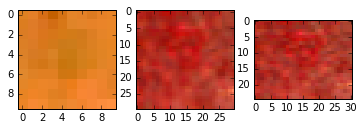

In [67]:
dg_arr.max(), image_resized.max(), image.dtype, image_resized.dtype

(2866, 2426.6049999999996, dtype('uint16'), dtype('float64'))

In [89]:
import skimage
skimage.__version__

'0.13.0'

In [ ]:
!conda update skimage